In [1]:
!pip install wordcloud

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
from wordcloud import WordCloud

In [3]:
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM, Conv1D, MaxPool1D
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score

In [5]:
from google.colab import files
import pandas as pd

# Upload your CSV files
uploaded = files.upload()

# Load the datasets
real_df = pd.read_csv('True.csv')
fake_df = pd.read_csv('Fake.csv')

Saving True.csv to True.csv
Saving Fake.csv to Fake.csv


/tmp/ipython-input-4114922916.py:9: DtypeWarning: Columns (4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171) have mixed types. Specify dtype option on import or set low_memory=False.
  fake_df = pd.read_csv('Fake.csv')


In [6]:
real_df.head()

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"


In [7]:
real_df.size

85668

In [8]:
fake_df.head()

,title,text,subject,date,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 162,Unnamed: 163,Unnamed: 164,Unnamed: 165,Unnamed: 166,Unnamed: 167,Unnamed: 168,Unnamed: 169,Unnamed: 170,Unnamed: 171
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
fake_df.size

4042344

In [10]:
fake_df.columns

Index(['title', 'text', 'subject', 'date', 'Unnamed: 4', 'Unnamed: 5',
       'Unnamed: 6', 'Unnamed: 7', 'Unnamed: 8', 'Unnamed: 9',
       ...
       'Unnamed: 162', 'Unnamed: 163', 'Unnamed: 164', 'Unnamed: 165',
       'Unnamed: 166', 'Unnamed: 167', 'Unnamed: 168', 'Unnamed: 169',
       'Unnamed: 170', 'Unnamed: 171'],
      dtype='object', length=172)

In [11]:
fake_df['subject'].value_counts()

,count
subject,
News,9050
politics,6838
left-news,4457
Government News,1570
US_News,775
Middle-east,770
of which Soros is a major financier.Mercy Corps: Vis a vis the Arab-Israeli conflict,2
claimed that hundreds of alternative media websites were producing fake news and conspiracy stories and therefore were unreliable as information sources. It wasn t long before the establishment began referencing these politicized lists,2
high taxes,2


<Axes: xlabel='subject', ylabel='count'>

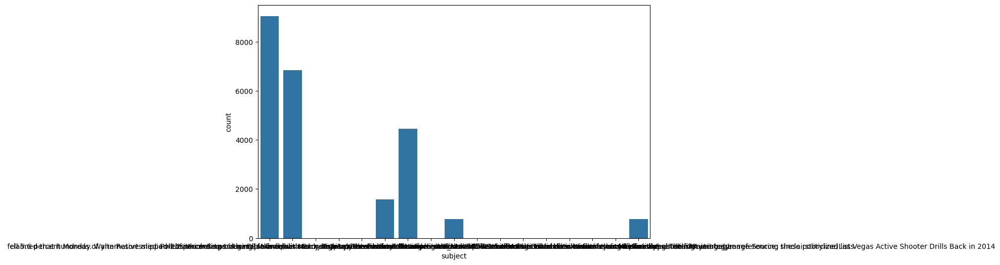

In [12]:
plt.figure(figsize = (10,6))
sns.countplot(x = 'subject', data = fake_df)

In [13]:
text = ' '.join(fake_df['text'].tolist())

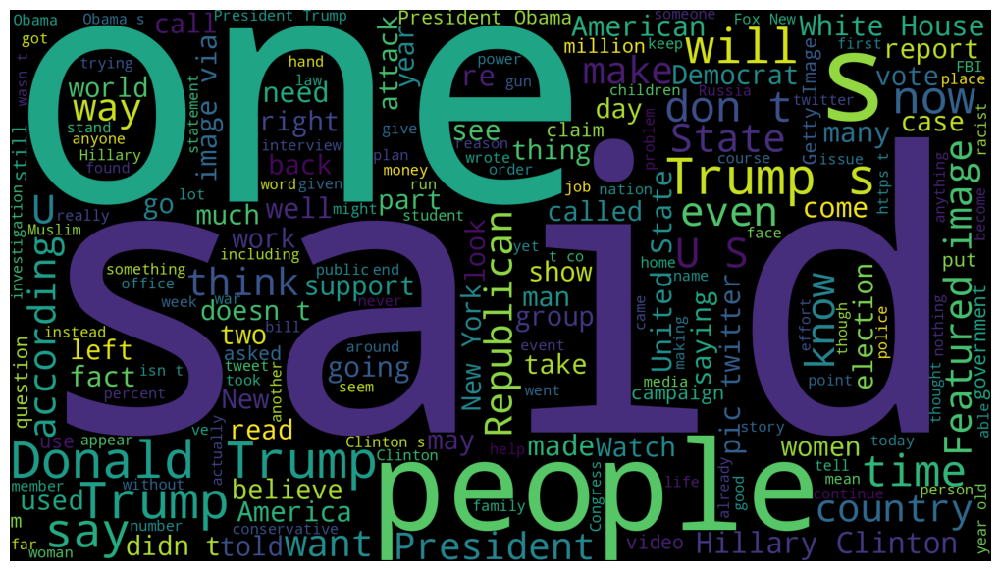

In [14]:
wordcloud = WordCloud(width=1920, height=1080).generate(text)
fig = plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [15]:
text = ' '.join(real_df['text'].tolist())

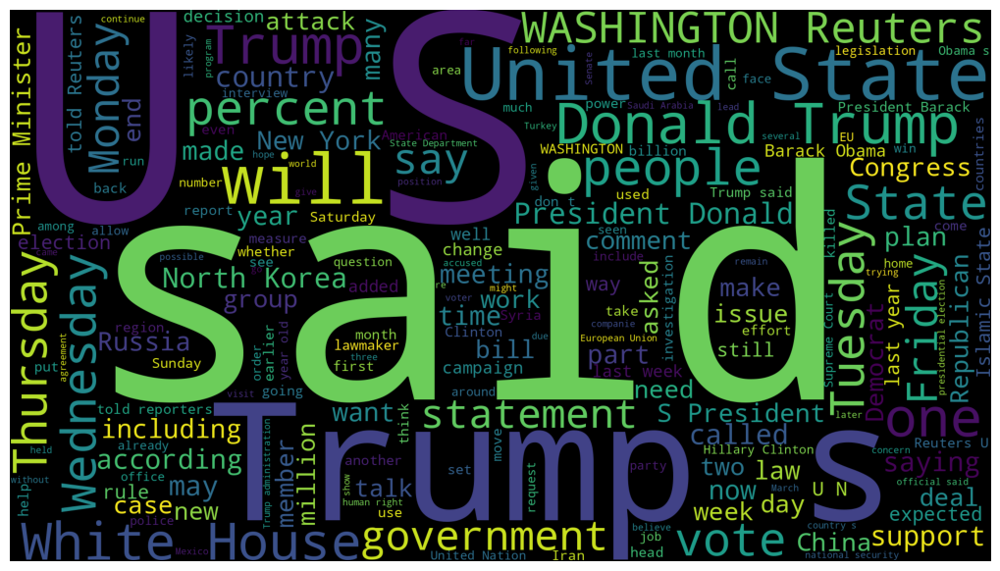

In [16]:
wordcloud = WordCloud(width=1920, height=1080).generate(text)
fig = plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

In [17]:
real_df.sample(5)

,title,text,subject,date
18830,North Korea insists U.S. student Warmbier wasn...,SEOUL (Reuters) - North Korea said on Thursday...,worldnews,"September 28, 2017"
13125,EU court adviser says Britain was wrong to ref...,LUXEMBOURG (Reuters) - Britain s rejection of ...,worldnews,"December 5, 2017"
18385,Death toll in Puerto Rico from Hurricane Maria...,(Reuters) - The death toll in Puerto Rico from...,worldnews,"October 4, 2017"
7005,Trump expected to name former Goldman banker M...,WASHINGTON (Reuters) - President-elect Donald ...,politicsNews,"November 29, 2016"
381,Factbox: Key Republicans in U.S. Senate tax bi...,WASHINGTON (Reuters) - Six more U.S. senators ...,politicsNews,"December 1, 2017"


In [18]:
unknown_publishers = []
for index, row in enumerate(real_df.text.values):
    try:
        record = row.split('-', maxsplit=1)
        record[1]
        assert(len(record[0])<120)
    except:
        unknown_publishers.append(index)

In [19]:
len(unknown_publishers)

222

In [20]:
real_df.iloc[unknown_publishers].text

,text
7,The following statements were posted to the ve...
8,The following statements were posted to the ve...
12,The following statements were posted to the ve...
13,The following statements were posted to the ve...
14,"(In Dec. 25 story, in second paragraph, corre..."
...,...
20135,(Story corrects to million from billion in pa...
20500,"(This Sept 8 story corrects headline, clarifi..."
20667,"(Story refiles to add dropped word not , in ..."
21246,(Story corrects third paragraph to show Mosul...


In [21]:
real_df.iloc[8970]

,8970
title,Graphic: Supreme Court roundup
text,
subject,politicsNews
date,"June 16, 2016"


In [22]:
real_df = real_df.drop(8970, axis=0)

In [23]:
publisher = []
temp_text = []

for index, row in enumerate(real_df.text.values):
    if index in unknown_publishers:
        temp_text.append(row)
        publisher.append('Unknown')
    else:
        record = row.split('-', maxsplit=1)
        publisher.append(record[0].strip())
        temp_text.append(record[1].strip())

In [24]:
real_df['publisher'] = publisher
real_df['text'] = temp_text

In [25]:
real_df.shape

(21416, 5)

In [26]:
empty_fake_index = [index for index, text in enumerate(fake_df.text.tolist()) if str(text).strip() == ""]

In [27]:
fake_df.iloc[empty_fake_index]

,title,text,subject,date,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 162,Unnamed: 163,Unnamed: 164,Unnamed: 165,Unnamed: 166,Unnamed: 167,Unnamed: 168,Unnamed: 169,Unnamed: 170,Unnamed: 171
10924,TAKE OUR POLL: Who Do You Think President Trum...,,politics,"May 10, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11042,Joe Scarborough BERATES Mika Brzezinski Over “...,,politics,"Apr 26, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11191,WATCH TUCKER CARLSON Scorch Sanctuary City May...,,politics,"Apr 6, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11226,MAYOR OF SANCTUARY CITY: Trump Trying To Make ...,,politics,"Apr 2, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11237,SHOCKER: Public School Turns Computer Lab Into...,,politics,"Apr 1, 2017",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21821,BALTIMORE BURNS: MARYLAND GOVERNOR BRINGS IN N...,,left-news,"Apr 27, 2015",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21831,FULL VIDEO: THE BLOCKBUSTER INVESTIGATION INTO...,,left-news,"Apr 25, 2015",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21832,(VIDEO) HILLARY CLINTON: RELIGIOUS BELIEFS MUS...,,left-news,"Apr 25, 2015",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21862,(VIDEO)ICE PROTECTING OBAMA: WON’T RELEASE NAM...,,left-news,"Apr 14, 2015",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
real_df['text'] = real_df['title'] + " " + real_df['text']
fake_df['text'] = fake_df['title'] + " " + fake_df['text']

In [29]:
real_df['text'] = real_df['text'].apply(lambda x: str(x).lower())
fake_df['text'] = fake_df['text'].apply(lambda x: str(x).lower())

In [30]:
real_df['class'] = 1
fake_df['class'] = 0

In [31]:
real_df.columns

Index(['title', 'text', 'subject', 'date', 'publisher', 'class'], dtype='object')

In [32]:
real_df = real_df[['text', 'class']]
fake_df = fake_df[['text', 'class']]


In [33]:
data = pd.concat([real_df, fake_df], ignore_index=True)

In [34]:
data.sample(5)

,text,class
8769,report accuses tennessee lawmaker of inappropr...,1
44097,3.57 degrees: kevin bacon’s cultural mantle sh...,0
14176,saudi arabia will help syrian opposition come ...,1
44438,boiler room #96 – the great lobster degeneracy...,0
41268,boom! wikileaks shows hillary speech to banker...,0


In [35]:
!pip install preprocess_kgptalkie

In [36]:
!pip install spacy
!python -m spacy download en_core_web_sm
!pip install beautifulsoup4
!pip install textblob

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 133.2 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [37]:
!pip install git+https://github.com/laxmimerit/preprocess_kgptalkie.git --upgrade --force-reinstall

  Cloning https://github.com/laxmimerit/preprocess_kgptalkie.git to /tmp/pip-req-build-fisjgeob
  Running command git clone --filter=blob:none --quiet https://github.com/laxmimerit/preprocess_kgptalkie.git /tmp/pip-req-build-fisjgeob
  Resolved https://github.com/laxmimerit/preprocess_kgptalkie.git to commit 0f56a6502679f6750b7f0ffed98f590d1f0246bd
  Preparing metadata (setup.py) ... done
  Created wheel for preprocess_kgptalkie: filename=preprocess_kgptalkie-0.11-py3-none-any.whl size=8174 sha256=d9a09b9a7fdd2a0a995e05263efdfc69a3dbe41443518acd39e3ad0e4ae7764b
  Stored in directory: /tmp/pip-ephem-wheel-cache-71vucb75/wheels/24/f6/5f/6a2a2252acab6c8ce06a71a210d40e9b744871a9132dbf59bc
Successfully built preprocess_kgptalkie
  Attempting uninstall: preprocess_kgptalkie
    Found existing installation: preprocess_kgptalkie 0.11
    Uninstalling preprocess_kgptalkie-0.11:
      Successfully uninstalled preprocess_kgptalkie-0.11


In [38]:
!pip uninstall httpcore httpx googletrans -y

Found existing installation: httpcore 1.0.9
Uninstalling httpcore-1.0.9:
  Successfully uninstalled httpcore-1.0.9
Found existing installation: httpx 0.28.1
Uninstalling httpx-0.28.1:
  Successfully uninstalled httpx-0.28.1


In [39]:
!pip install httpcore==1.0.9 httpx==0.27.2 googletrans==4.0.2


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.8/78.8 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 7.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
firebase-admin 6.9.0 requires httpx[http2]==0.28.1, but you have httpx 0.27.2 which is incompatible.
google-genai 1.48.0 requires httpx<1.0.0,>=0.28.1, but you have httpx 0.27.2 which is incompatible.


In [40]:
import preprocess_kgptalkie as ps

In [41]:
data['text'] = data['text'].apply(lambda x: ps.remove_special_chars(x))

In [42]:
data.head()

,text,class
0,as us budget fight looms republicans flip thei...,1
1,us military to accept transgender recruits on ...,1
2,senior us republican senator let mr mueller do...,1
3,fbi russia probe helped by australian diplomat...,1
4,trump wants postal service to charge much more...,1


In [43]:
!pip install gensim

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.9/27.9 MB 33.0 MB/s eta 0:00:00


In [44]:
import gensim

In [45]:
y = data['class'].values

In [46]:
X = [d.split()for d in data['text'].tolist()]

In [47]:
X

[['as',
  'us',
  'budget',
  'fight',
  'looms',
  'republicans',
  'flip',
  'their',
  'fiscal',
  'script',
  'the',
  'head',
  'of',
  'a',
  'conservative',
  'republican',
  'faction',
  'in',
  'the',
  'us',
  'congress',
  'who',
  'voted',
  'this',
  'month',
  'for',
  'a',
  'huge',
  'expansion',
  'of',
  'the',
  'national',
  'debt',
  'to',
  'pay',
  'for',
  'tax',
  'cuts',
  'called',
  'himself',
  'a',
  'fiscal',
  'conservative',
  'on',
  'sunday',
  'and',
  'urged',
  'budget',
  'restraint',
  'in',
  '2018',
  'in',
  'keeping',
  'with',
  'a',
  'sharp',
  'pivot',
  'under',
  'way',
  'among',
  'republicans',
  'us',
  'representative',
  'mark',
  'meadows',
  'speaking',
  'on',
  'cbs',
  'face',
  'the',
  'nation',
  'drew',
  'a',
  'hard',
  'line',
  'on',
  'federal',
  'spending',
  'which',
  'lawmakers',
  'are',
  'bracing',
  'to',
  'do',
  'battle',
  'over',
  'in',
  'january',
  'when',
  'they',
  'return',
  'from',
  'the',
  

In [48]:
DIM = 100
w2v_model = gensim.models.Word2Vec(sentences=X, vector_size=DIM, window=10, min_count=1)

In [49]:
len(w2v_model.wv.key_to_index)

230665

In [50]:
w2v_model.wv['love']

array([-0.12308369,  1.5646983 , -0.32181555,  0.5752348 , -2.0196173 ,
       -1.8135998 ,  4.0801573 ,  2.1976166 , -1.3747432 ,  1.1862088 ,
       -2.425007  , -3.282429  , -3.7866204 , -2.140836  , -4.516652  ,
        1.6593236 , -4.622209  , -1.4352659 ,  4.0466504 ,  0.11344468,
       -0.8893381 ,  0.27650228, -0.4468093 ,  0.9685445 ,  0.6142392 ,
        5.0270114 , -1.0850459 , -2.4352386 ,  1.6138245 ,  0.935097  ,
        1.8437359 , -1.8720648 , -0.23501104,  0.4027579 , -2.8718607 ,
        0.5600234 ,  2.8010361 , -0.37785253,  0.46861786, -2.3401682 ,
        1.7607577 , -2.6708798 , -3.9280035 , -2.09669   , -2.1698904 ,
        1.1534474 ,  3.3205123 , -4.9952765 , -0.11628196, -2.4208498 ,
       -5.151246  ,  1.4864287 ,  0.57421315, -1.4978448 ,  2.0929356 ,
       -0.02781714, -2.1469564 , -1.4657568 , -3.8728518 , -1.4699639 ,
       -2.835894  , -1.365517  ,  0.18423973,  0.2616248 ,  3.0275774 ,
        1.9998579 ,  0.360964  ,  0.72528243, -3.4610038 , -0.19

In [51]:
w2v_model.wv.most_similar('india')

[('pakistan', 0.7210542559623718),
 ('malaysia', 0.6822278499603271),
 ('indian', 0.6546916365623474),
 ('modi', 0.6371189951896667),
 ('china', 0.6316662430763245),
 ('narendra', 0.6113286018371582),
 ('indias', 0.6093799471855164),
 ('australia', 0.6093656420707703),
 ('thailand', 0.5987945795059204),
 ('chinas', 0.5871803760528564)]

In [52]:
tokenizer = Tokenizer()
tokenizer.fit_on_texts(X)

In [53]:
X = tokenizer.texts_to_sequences(X)

In [54]:
X

[[18,
  30,
  474,
  481,
  10657,
  132,
  8080,
  40,
  1379,
  5163,
  1,
  419,
  3,
  4,
  301,
  79,
  6304,
  6,
  1,
  30,
  189,
  29,
  772,
  26,
  279,
  9,
  4,
  1108,
  2965,
  3,
  1,
  123,
  952,
  2,
  448,
  9,
  184,
  1194,
  173,
  391,
  4,
  1379,
  301,
  8,
  342,
  5,
  1107,
  474,
  7795,
  6,
  1181,
  6,
  1761,
  16,
  4,
  3403,
  7883,
  141,
  165,
  318,
  132,
  30,
  798,
  923,
  7796,
  674,
  8,
  2006,
  475,
  1,
  383,
  1757,
  4,
  559,
  588,
  8,
  168,
  697,
  50,
  408,
  28,
  17322,
  2,
  89,
  1352,
  65,
  6,
  410,
  60,
  32,
  776,
  25,
  1,
  8148,
  8,
  203,
  408,
  39,
  1437,
  350,
  2,
  929,
  4,
  168,
  474,
  6,
  4,
  481,
  304,
  2,
  22,
  1961,
  2,
  80,
  425,
  170,
  18,
  313,
  210,
  107,
  18,
  1,
  516,
  569,
  96,
  1780,
  1503,
  6,
  50,
  132,
  39,
  1072,
  2,
  377,
  349,
  3,
  189,
  37,
  68,
  14,
  5,
  19,
  132,
  181,
  4,
  381,
  474,
  960,
  6,
  169,
  697,
  110,
  196,
  62,

In [55]:
tokenizer.word_index

{'the': 1,
 'to': 2,
 'of': 3,
 'a': 4,
 'and': 5,
 'in': 6,
 'that': 7,
 'on': 8,
 'for': 9,
 's': 10,
 'is': 11,
 'he': 12,
 'said': 13,
 'trump': 14,
 'it': 15,
 'with': 16,
 'was': 17,
 'as': 18,
 'his': 19,
 'by': 20,
 'has': 21,
 'be': 22,
 'have': 23,
 'not': 24,
 'from': 25,
 'this': 26,
 'at': 27,
 'are': 28,
 'who': 29,
 'us': 30,
 'an': 31,
 'they': 32,
 'i': 33,
 'but': 34,
 'we': 35,
 'would': 36,
 'president': 37,
 'about': 38,
 'will': 39,
 'their': 40,
 'had': 41,
 'you': 42,
 't': 43,
 'been': 44,
 'were': 45,
 'people': 46,
 'more': 47,
 'or': 48,
 'after': 49,
 'which': 50,
 'she': 51,
 'her': 52,
 'one': 53,
 'if': 54,
 'its': 55,
 'out': 56,
 'all': 57,
 'what': 58,
 'state': 59,
 'when': 60,
 'new': 61,
 'also': 62,
 'up': 63,
 'there': 64,
 'over': 65,
 'no': 66,
 'house': 67,
 'donald': 68,
 'our': 69,
 'clinton': 70,
 'states': 71,
 'obama': 72,
 'government': 73,
 'can': 74,
 'just': 75,
 'him': 76,
 'so': 77,
 'than': 78,
 'republican': 79,
 'other': 80,
 'so

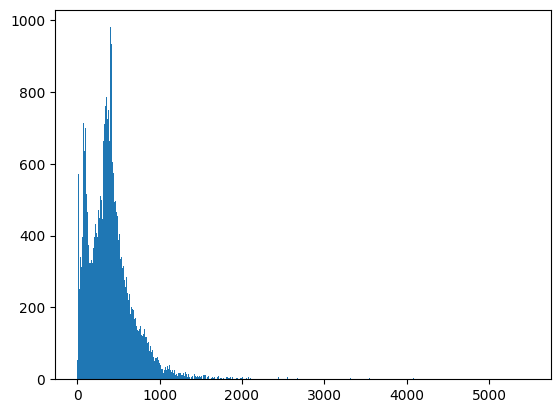

In [56]:
plt.hist([len(x) for x in X], bins = 700)
plt.show()

In [57]:
nos = np.array([len(x) for x in X])
len(nos[nos>1000])

1584

In [58]:
maxlen = 1000
x = pad_sequences(X, maxlen=maxlen)

In [59]:
len(X[101])

854

In [60]:
vocab_size = len(tokenizer.word_index) + 1
vocab = tokenizer.word_index


In [61]:
def get_weight_matrix(model):

    weight_matrix = np.zeros((vocab_size, DIM))

    for word, i in vocab.items():
        weight_matrix[i] = model.wv[word]  # Shift indices by 1

    return weight_matrix

In [62]:
embedding_vectors = get_weight_matrix(w2v_model)

In [63]:
embedding_vectors.shape

(230666, 100)

In [64]:
model = Sequential()
model.add(Embedding(input_dim=vocab_size, output_dim=DIM, weights=[embedding_vectors], input_shape=(maxlen,), trainable=False))
model.add(LSTM(units=128))
model.add(Dense(1, activation='sigmoid'))
model.compile(optimizer='adam', loss='binary_crossentropy', metrics = ['acc'])

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/embedding.py:100: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [65]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ (None, 1000, 100)      │    23,066,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 128)            │       117,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,183,977 (88.44 MB)

 Trainable params: 117,377 (458.50 KB)

 Non-trainable params: 23,066,600 (87.99 MB)

In [66]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3,random_state=42)

In [67]:
from keras.preprocessing.sequence import pad_sequences

# Pad sequences to the same length FIRST
max_length = 1000  # or whatever length you want
X_train_padded = pad_sequences(X_train, maxlen=max_length, padding='post')
X_test_padded = pad_sequences(X_test, maxlen=max_length, padding='post')

# NOW convert to NumPy arrays (they already are, but explicit conversion doesn't hurt)
X_train = np.array(X_train_padded)
y_train = np.array(y_train)
X_test = np.array(X_test_padded)
y_test = np.array(y_test)

In [68]:
model.fit(X_train, y_train, validation_split = 0.3, epochs=6, batch_size=8)

Epoch 1/6
2752/2752 ━━━━━━━━━━━━━━━━━━━━ 107s 38ms/step - acc: 0.5321 - loss: 0.6819 - val_acc: 0.5246 - val_loss: 0.6821
Epoch 2/6
2752/2752 ━━━━━━━━━━━━━━━━━━━━ 101s 37ms/step - acc: 0.5436 - loss: 0.6696 - val_acc: 0.5246 - val_loss: 0.6818
Epoch 3/6
2752/2752 ━━━━━━━━━━━━━━━━━━━━ 102s 37ms/step - acc: 0.5484 - loss: 0.6615 - val_acc: 0.5765 - val_loss: 0.6540
Epoch 4/6
2752/2752 ━━━━━━━━━━━━━━━━━━━━ 102s 37ms/step - acc: 0.7927 - loss: 0.4015 - val_acc: 0.9614 - val_loss: 0.1174
Epoch 5/6
2752/2752 ━━━━━━━━━━━━━━━━━━━━ 105s 38ms/step - acc: 0.9688 - loss: 0.1153 - val_acc: 0.9775 - val_loss: 0.0894
Epoch 6/6
2752/2752 ━━━━━━━━━━━━━━━━━━━━ 102s 37ms/step - acc: 0.9673 - loss: 0.0997 - val_acc: 0.9753 - val_loss: 0.0859


In [69]:
y_pred = (model.predict(X_test) >= 0.5).astype(int)


422/422 ━━━━━━━━━━━━━━━━━━━━ 6s 14ms/step


In [70]:
accuracy_score(y_test, y_pred)

0.9787028791926388

In [71]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      6979
           1       0.98      0.97      0.98      6497

    accuracy                           0.98     13476
   macro avg       0.98      0.98      0.98     13476
weighted avg       0.98      0.98      0.98     13476



In [74]:
x = ['On January 9, 2020, on the "CBS Morning News," Anne-Marie Green reported about a new virus, related to SARS, that was possibly responsible for a mysterious pneumonia outbreak in China: "The new coronavirus was found in 15 of 59 patients with the illness.']
x_seq = tokenizer.texts_to_sequences(x)
x_pad = pad_sequences(x_seq, maxlen=maxlen)      # Shape should be (1, maxlen)

# Predict returns array of probabilities for batch input, so index [0][0] for scalar
y_prob = model.predict(x_pad)[0][0]
y_pred = int(y_prob >= 0.5)

print("Prediction:", y_pred)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
Prediction: 1


In [75]:
x = ['This is a news']
x_seq = tokenizer.texts_to_sequences(x)
x_pad = pad_sequences(x_seq, maxlen=maxlen)      # Shape should be (1, maxlen)

# Predict returns array of probabilities for batch input, so index [0][0] for scalar
y_prob = model.predict(x_pad)[0][0]
y_pred = int(y_prob >= 0.5)

print("Prediction:", y_pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
Prediction: 0
